# YOLOv11 Traffic Sign Detection - Miguel Baldacchino

## 1. Library Imports


In [ ]:
import os
import random
import time
import math
import yaml

from pathlib import Path
import pandas as pd

import cv2
from ultralytics import YOLO

import torch
from torchmetrics.detection.mean_ap import MeanAveragePrecision

import numpy as np
from PIL import Image, ImageOps

import matplotlib.pyplot as plt
import matplotlib.patches as patches
from collections import defaultdict

## 2. Hardware & CUDA Verification

In [10]:
print("Torch version:", torch.__version__)
print("CUDA available:", torch.cuda.is_available())

if torch.cuda.is_available():
    print("GPU:", torch.cuda.get_device_name(0))

Torch version: 2.5.1+cu121
CUDA available: True
GPU: NVIDIA GeForce RTX 3070


## 3. Project Paths & Configuration

In [11]:
DATASET_ROOT = "D:/CV/Advanced-CV---Group-Assignment/ARI3129 - Assignment Materials/YOLO_COCO"
DATA_YAML = f"{DATASET_ROOT}/data.yaml"

TRAINED_WEIGHTS = (
    r"D:\CV\Advanced-CV---Group-Assignment\runs\detect\runs\detect"
    r"\yolo_sign_detection_100ep_768\weights\best.pt"
)

## 4. Dataset Overview

In [ ]:
with open(DATA_YAML, "r") as f:
    data_cfg = yaml.safe_load(f)

data_cfg

{'path': 'D:/CV/Advanced-CV---Group-Assignment/ARI3129 - Assignment Materials/YOLO_COCO',
 'train': 'images/train',
 'val': 'images/val',
 'test': 'images/test',
 'names': {0: 'blind_spot_mirror',
  1: 'no_entry',
  2: 'no_through_road',
  3: 'pedestrian_crossing',
  4: 'roundabout_ahead',
  5: 'stop'}}

In [ ]:
def load_image_exif_safe(path):
    image = Image.open(path)
    image = ImageOps.exif_transpose(image) 
    return np.array(image)

## 5. Data Configuration (data.yaml)

In [15]:
print("Train:", data_cfg["train"])
print("Val:", data_cfg["val"])
print("Test:", data_cfg.get("test"))

Train: images/train
Val: images/val
Test: images/test


## 6. Model Selection & Initialization

In [16]:
model = YOLO("yolo11n.pt")

## 7. Training Configuration

In [17]:
EPOCHS = 100
IMG_SIZE = 768
BATCH = 16
DEVICE = 0

## 8. Model Training

In [ ]:

results = model.train(
    data=DATA_YAML,
    epochs=100,
    imgsz=768,
    batch=16,              
    optimizer="AdamW",
    lr0=0.003,
    lrf=0.01,
    cos_lr=True,
    warmup_epochs=3,

    # Augmentation 
    hsv_h=0.015,
    hsv_s=0.7,
    hsv_v=0.4,
    degrees=5.0,
    translate=0.1,
    scale=0.4,
    shear=0.0,
    fliplr=0.5,
    mosaic=1.0,
    mixup=0.0,

    device=0,
    workers=8,
    patience=15,

    project="runs/detect",
    name="yolo_sign_detection_100ep_768",
    exist_ok=True
)


New https://pypi.org/project/ultralytics/8.4.6 available  Update with 'pip install -U ultralytics'
Ultralytics 8.4.5  Python-3.11.9 torch-2.5.1+cu121 CUDA:0 (NVIDIA GeForce RTX 3070, 8192MiB)
engine\trainer: agnostic_nms=False, amp=True, angle=1.0, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=True, cutmix=0.0, data=D:/CV/Advanced-CV---Group-Assignment/ARI3129 - Assignment Materials/YOLO_COCO/data.yaml, degrees=5.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=100, erasing=0.4, exist_ok=True, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=768, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.003, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11n.pt, momentum=0.937

## Metrics

In [ ]:
metrics = model.val(
    data=DATA_YAML,
    split="test",
    device=0
)

print(metrics)

Ultralytics 8.4.5  Python-3.11.9 torch-2.5.1+cu121 CUDA:0 (NVIDIA GeForce RTX 3070, 8192MiB)
YOLO11n summary (fused): 101 layers, 2,583,322 parameters, 0 gradients, 6.3 GFLOPs
val: Fast image access  (ping: 4.69.1 ms, read: 68.339.9 MB/s, size: 4032.7 KB)
val: Scanning D:\CV\Advanced-CV---Group-Assignment\ARI3129 - Assignment Materials\YOLO_COCO\labels\test.cache... 138 images, 0 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 138/138  0.0s
val: D:\CV\Advanced-CV---Group-Assignment\ARI3129 - Assignment Materials\YOLO_COCO\images\test\20251112_123519.jpg: corrupt JPEG restored and saved
val: D:\CV\Advanced-CV---Group-Assignment\ARI3129 - Assignment Materials\YOLO_COCO\images\test\20251115_145701.jpg: corrupt JPEG restored and saved
val: D:\CV\Advanced-CV---Group-Assignment\ARI3129 - Assignment Materials\YOLO_COCO\images\test\20251130_114922.jpg: corrupt JPEG restored and saved
val: D:\CV\Advanced-CV---Group-Assignment\ARI3129 - Assignment Materials\YOLO_COCO\images\test\20251130_115024.jpg: c

## Model Loading

In [20]:
model = YOLO(r"D:\CV\Advanced-CV---Group-Assignment\runs\detect\runs\detect\yolo_sign_detection_100ep_768\weights\best.pt")

## Visualisation of YOLOv11 Detection Predictions on Test Images

Found 138 predicted images


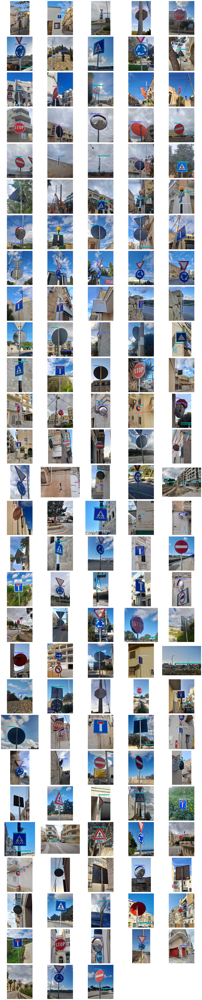

In [ ]:
PRED_DIR = Path("D:/CV/Advanced-CV---Group-Assignment/runs/detect/predict2")

images = sorted(PRED_DIR.glob("*.jpg"))
print(f"Found {len(images)} predicted images")

cols = 5
rows = math.ceil(len(images) / cols)

fig, axes = plt.subplots(rows, cols, figsize=(20, rows * 3.5))
axes = axes.ravel()

for ax, img_path in zip(axes, images):
    img = cv2.imread(str(img_path))
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    ax.imshow(img)
    ax.axis("off")

for ax in axes[len(images):]:
    ax.axis("off")

plt.tight_layout()
plt.show()


## Training vs. Validation Loss

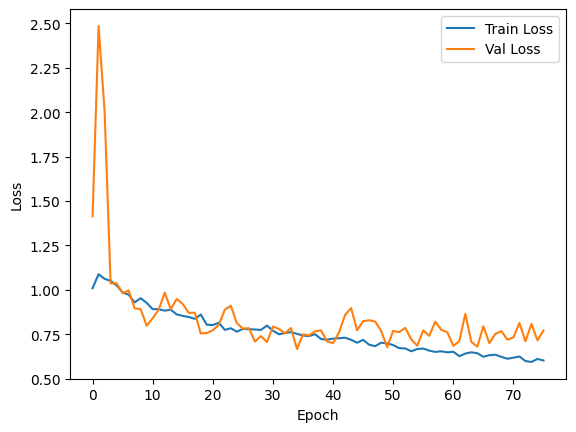

In [26]:
df = pd.read_csv("D:/CV/Advanced-CV---Group-Assignment/runs/detect/runs/detect/yolo_sign_detection_100ep_768/results.csv")

train_loss = df["train/box_loss"]
val_loss = df["val/box_loss"]

plt.plot(train_loss, label="Train Loss")
plt.plot(val_loss, label="Val Loss")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.legend()
plt.show()


## Ground Truth vs. Predictions

In [ ]:
# paths
TEST_IMG_DIR = "D:/CV/Advanced-CV---Group-Assignment/ARI3129 - Assignment Materials/YOLO_COCO/images/test"
TEST_LBL_DIR = "D:/CV/Advanced-CV---Group-Assignment/ARI3129 - Assignment Materials/YOLO_COCO/labels/test"

CONF_THRES = 0.5  

model.eval()

gt_counts = defaultdict(int)
pred_counts = defaultdict(int)

for img_name in os.listdir(TEST_IMG_DIR):
    img_path = os.path.join(TEST_IMG_DIR, img_name)
    lbl_path = os.path.join(TEST_LBL_DIR, img_name.replace(".jpg", ".txt"))

    img = cv2.imread(img_path)
    h, w = img.shape[:2]

    # Ground Truth
    if os.path.exists(lbl_path):
        with open(lbl_path) as f:
            for line in f:
                cls = int(line.split()[0])
                gt_counts[cls] += 1

    # Predictions
    results = model.predict(img, conf=CONF_THRES, iou=0.5, verbose=False)[0]

    for cls in results.boxes.cls.cpu().numpy().astype(int):
        pred_counts[cls] += 1


In [40]:
class_names = model.names
classes = sorted(set(gt_counts.keys()) | set(pred_counts.keys()))

gt_vals = [gt_counts[c] for c in classes]
pred_vals = [pred_counts[c] for c in classes]
labels = [class_names[c] for c in classes]

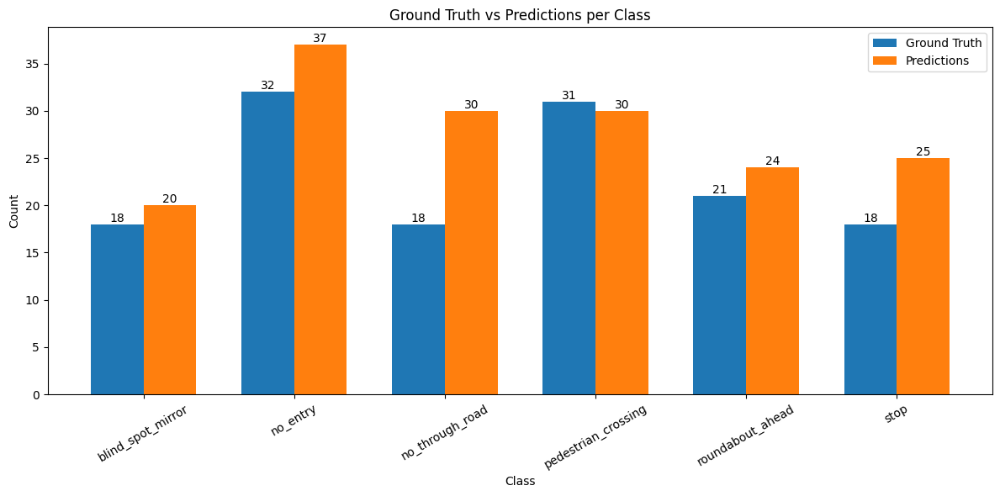

In [ ]:
x = np.arange(len(classes))
width = 0.35

plt.figure(figsize=(12, 6))
bars_gt = plt.bar(x - width/2, gt_vals, width, label="Ground Truth")
bars_pred = plt.bar(x + width/2, pred_vals, width, label="Predictions")

plt.xlabel("Class")
plt.ylabel("Count")
plt.title("Ground Truth vs Predictions per Class")
plt.xticks(x, labels, rotation=30)
plt.legend()

def add_labels(bars):
    for bar in bars:
        height = bar.get_height()
        plt.text(
            bar.get_x() + bar.get_width()/2,
            height,
            f"{int(height)}",
            ha="center",
            va="bottom",
            fontsize=10
        )

add_labels(bars_gt)
add_labels(bars_pred)

plt.tight_layout()
plt.show()


## Map Scores, F-1 Score, Recall, Precision

In [ ]:
f1 = 2 * (metrics.box.p.mean() * metrics.box.r.mean()) / (
    metrics.box.p.mean() + metrics.box.r.mean() + 1e-6
)

results_dict = {
    "Metric": [
        "Precision",
        "Recall",
        "F1-score",
        "mAP@50",
        "mAP@50–95"
    ],
    "Value": [
        metrics.box.p.mean(),
        metrics.box.r.mean(),
        f1,
        metrics.box.map50,
        metrics.box.map
    ]
}

metrics_df = pd.DataFrame(results_dict)
metrics_df


,Metric,Value
0,Precision,0.906328
1,Recall,0.775467
2,F1-score,0.835806
3,mAP@50,0.869854
4,mAP@50–95,0.729002


In [44]:
class_names = model.model.names

per_class_df = pd.DataFrame({
    "Class": class_names.values(),
    "Precision": metrics.box.p,
    "Recall": metrics.box.r,
    "AP@50": metrics.box.ap50,
    "AP@50–95": metrics.box.ap
})

per_class_df


,Class,Precision,Recall,AP@50,AP@50–95
0,blind_spot_mirror,0.937682,0.750000,0.861036,0.722138
1,no_entry,0.937422,0.680941,0.808064,0.657507
2,no_through_road,0.909654,0.846154,0.928197,0.785700
3,pedestrian_crossing,0.846287,0.667373,0.791193,0.625024
4,roundabout_ahead,0.930541,0.875000,0.943522,0.830451
5,stop,0.876386,0.833333,0.887111,0.753191


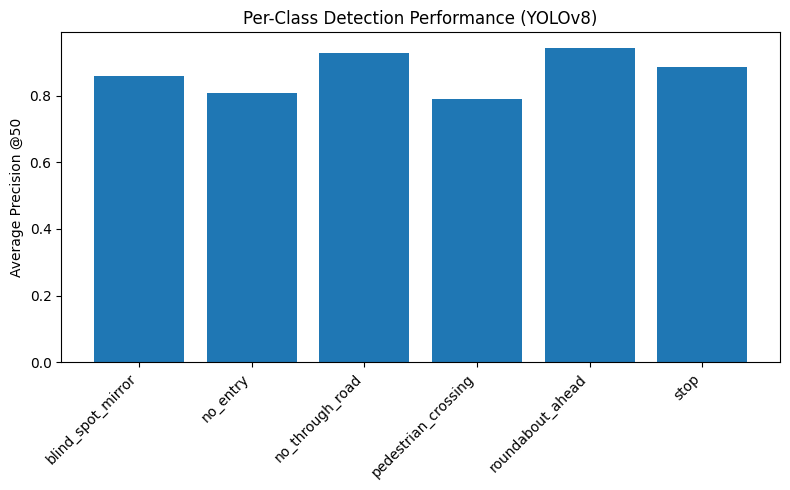

In [ ]:
plt.figure(figsize=(8, 5))
plt.bar(per_class_df["Class"], per_class_df["AP@50"])
plt.xticks(rotation=45, ha="right")
plt.ylabel("Average Precision @50")
plt.title("Per-Class Detection Performance (YOLOv8)")
plt.tight_layout()
plt.show()

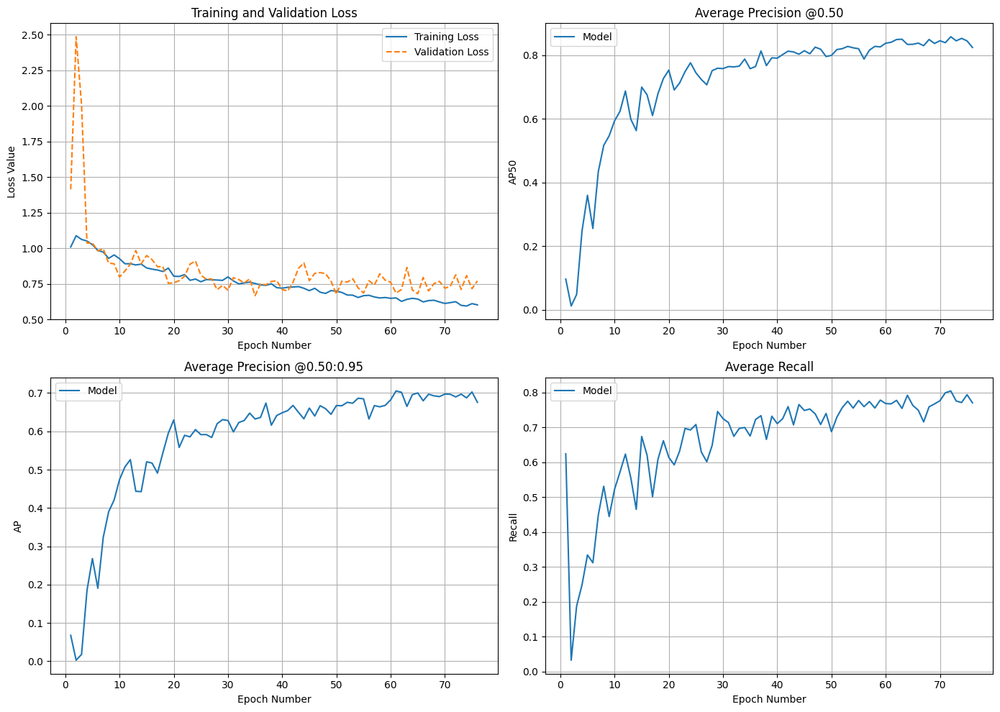

In [ ]:
csv_path = (
    "D:/CV/Advanced-CV---Group-Assignment/"
    "runs/detect/runs/detect/"
    "yolo_sign_detection_100ep_768/results.csv"
)

df = pd.read_csv(csv_path)
epochs = df["epoch"]

fig, axs = plt.subplots(2, 2, figsize=(14, 10))

# (1) Training & Validation Loss
axs[0, 0].plot(epochs, df["train/box_loss"], label="Training Loss")
axs[0, 0].plot(epochs, df["val/box_loss"], linestyle="--", label="Validation Loss")
axs[0, 0].set_title("Training and Validation Loss")
axs[0, 0].set_xlabel("Epoch Number")
axs[0, 0].set_ylabel("Loss Value")
axs[0, 0].legend()
axs[0, 0].grid(True)

# (2) AP@0.50
axs[0, 1].plot(epochs, df["metrics/mAP50(B)"], label="Model")
axs[0, 1].set_title("Average Precision @0.50")
axs[0, 1].set_xlabel("Epoch Number")
axs[0, 1].set_ylabel("AP50")
axs[0, 1].legend()
axs[0, 1].grid(True)

# (3) AP@0.50:0.95
axs[1, 0].plot(epochs, df["metrics/mAP50-95(B)"], label="Model")
axs[1, 0].set_title("Average Precision @0.50:0.95")
axs[1, 0].set_xlabel("Epoch Number")
axs[1, 0].set_ylabel("AP")
axs[1, 0].legend()
axs[1, 0].grid(True)

# (4) Recall
axs[1, 1].plot(epochs, df["metrics/recall(B)"], label="Model")
axs[1, 1].set_title("Average Recall")
axs[1, 1].set_xlabel("Epoch Number")
axs[1, 1].set_ylabel("Recall")
axs[1, 1].legend()
axs[1, 1].grid(True)

plt.tight_layout()
plt.savefig("metric_plot.png", dpi=300)
plt.show()
